Models without DayOfWeek and HDH perform better from train to validation. Years 2018-2019 data looks better

# Gradient Boosting Regressor

In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ecotools.pi_client import pi_client

sns.set('paper')
# Option Paramater time_zone
# default timezone is time_zone='America/Los_Angeles' use https://www.iana.org/time-zones 

#pi = pi_client(username= r'ad3\username')
pi = pi_client(username = r'ad3\dlrueda')

ad3\dlrueda, please provide your password (text will be hidden) 
>>········
save password? [y/n] /n after saving, set username = 'file' to use this feature 
>>n


In [80]:
# tags = pi.search_by_point(['aiTIT4045*'])

tags = pi.search_by_point(['Chemistry_ChilledWater_Demand_kBtu', 'aiTIT4045'])

tags

['Chemistry_ChilledWater_Demand_kBtu', 'aiTIT4045']

In [81]:
# Required parameters
start = '2019-01-01'
end = '2020-01-01'    

calc = 'summary' # Can be 'summary', 'interpolated', or 'recorded'
interval = '1h' # Can be '15min', '1h', '1d', or '1mo'   

# Extras
chunk_size = 10
weight = 'TimeWeighted'
summary_calc = 'average' # Can be 'average', 'minimum', 'maximum', 'range', 'stddev', 'count', 'percentgood', 'max', 'total', 'none', 'all'
max_count = round(1500000/len(tags))

df = pi.get_stream_by_point(tags, start=start, end=end, _convert_cols=False, calculation=calc, 
                            interval=interval, _weight=weight, _summary_type=summary_calc, _max_count=max_count, 
                            _chunk_size=chunk_size)
df.head()

18:24:52: Sending API request... Chunk 1 of 1
18:24:55: Response recieved for 2 tags! (2.88)


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045
Timestamp,,
2019-01-01 00:00:00,303.884804,41.556886
2019-01-01 01:00:00,311.113570,41.994667
2019-01-01 02:00:00,305.841731,40.879091
2019-01-01 03:00:00,296.959590,41.991956
2019-01-01 04:00:00,298.393641,41.944634


## EDA

In [4]:
import matplotlib as mpl
mpl.style.use('seaborn-whitegrid')

Text(0, 0.5, 'Demand kBtu')

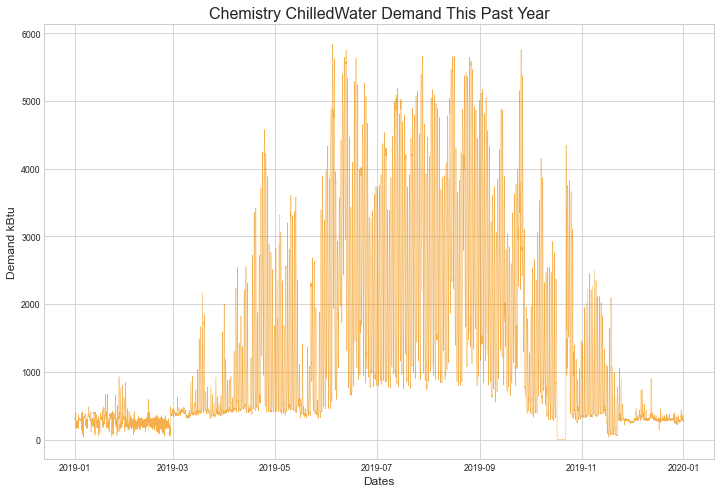

In [83]:
plt.figure(figsize=(12,8))
plt.plot(df['Chemistry_ChilledWater_Demand_kBtu'], color='#F18F01', linewidth=0.5, alpha = 0.7)


plt.title('Chemistry ChilledWater Demand This Past Year', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

Text(0, 0.5, 'Degrees')

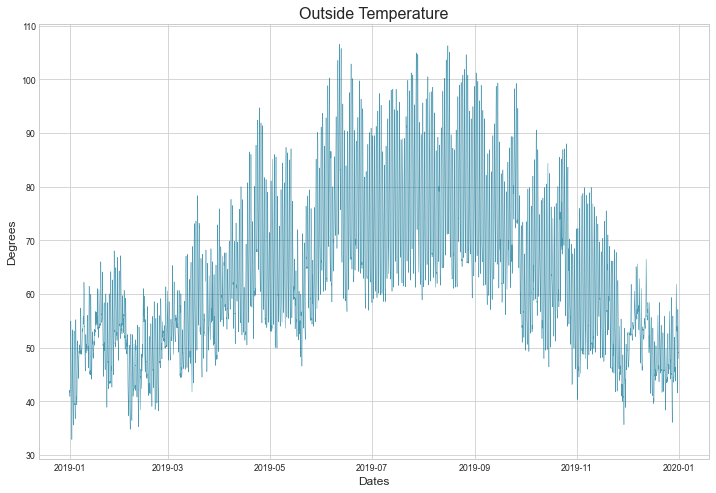

In [84]:
plt.figure(figsize=(12,8))
plt.plot(df['aiTIT4045'], color='#006E90', linewidth=0.5, alpha = 0.7)


plt.title('Outside Temperature', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Degrees', fontsize = 12)


## Add HDH

In [85]:
df['HDH'] = 65 - df['aiTIT4045']
df.loc[df['HDH'] < 0, 'HDH'] = 0
df


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH
Timestamp,,,
2019-01-01 00:00:00,303.884804,41.556886,23.443114
2019-01-01 01:00:00,311.113570,41.994667,23.005333
2019-01-01 02:00:00,305.841731,40.879091,24.120909
2019-01-01 03:00:00,296.959590,41.991956,23.008044
2019-01-01 04:00:00,298.393641,41.944634,23.055366
...,...,...,...
2019-12-31 19:00:00,292.365134,50.228319,14.771681
2019-12-31 20:00:00,283.402840,49.972321,15.027679
2019-12-31 21:00:00,287.967682,49.017716,15.982284


## Add CDH

In [86]:
df['CDH'] = (df['aiTIT4045'] - 65)**2
df.loc[df['CDH'] < 0, 'CDH'] = 0
df.head()


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH
Timestamp,,,,
2019-01-01 00:00:00,303.884804,41.556886,23.443114,549.579581
2019-01-01 01:00:00,311.113570,41.994667,23.005333,529.245361
2019-01-01 02:00:00,305.841731,40.879091,24.120909,581.818238
2019-01-01 03:00:00,296.959590,41.991956,23.008044,529.370111
2019-01-01 04:00:00,298.393641,41.944634,23.055366,531.549892


## Add Day of Week

In [87]:
df.reset_index(inplace=True)
df['DayOfWeek'] = df['Timestamp'].dt.strftime('%w')
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek
0,2019-01-01 00:00:00,303.884804,41.556886,23.443114,549.579581,2
1,2019-01-01 01:00:00,311.113570,41.994667,23.005333,529.245361,2
2,2019-01-01 02:00:00,305.841731,40.879091,24.120909,581.818238,2
3,2019-01-01 03:00:00,296.959590,41.991956,23.008044,529.370111,2
4,2019-01-01 04:00:00,298.393641,41.944634,23.055366,531.549892,2


## Add Holiday

In [119]:
tags = pi.search_by_point(['ACE_Holidays_Boolean'])

tags

['ACE_Holidays_Boolean']

In [120]:
# Required parameters
start = '2018-09-01'
end = '2019-09-01'    

calc = 'summary' # Can be 'summary', 'interpolated', or 'recorded'
interval = '1h' # Can be '15min', '1h', '1d', or '1mo'   

# Extras
chunk_size = 10
weight = 'TimeWeighted'
summary_calc = 'average' # Can be 'average', 'minimum', 'maximum', 'range', 'stddev', 'count', 'percentgood', 'max', 'total', 'none', 'all'
max_count = round(1500000/len(tags))

hol = pi.get_stream_by_point(tags, start=start, end=end, _convert_cols=False, calculation=calc, 
                            interval=interval, _weight=weight, _summary_type=summary_calc, _max_count=max_count, 
                            _chunk_size=chunk_size)
hol.head()

19:34:26: Sending API request... Chunk 1 of 1
19:34:27: Response recieved for 1 tags! (0.55)


,ACE_Holidays_Boolean
Timestamp,
2018-09-01 00:00:00,1.0
2018-09-01 01:00:00,1.0
2018-09-01 02:00:00,1.0
2018-09-01 03:00:00,1.0
2018-09-01 04:00:00,1.0


In [121]:
hol.reset_index(inplace=True)

In [122]:
df['Holiday'] = hol.ACE_Holidays_Boolean
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0


## Add Month of year

In [123]:
df['Month'] = pd.to_datetime(df['Timestamp']).apply(lambda x: '{month}'.format(month = x.month))
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday,Month
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0,9
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0,9
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0,9
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0,9
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0,9


## Add hour

In [124]:
#df.reset_index(inplace=True)
df['Hour'] = pd.to_datetime(df['Timestamp']).apply(lambda x: '{hour}'.format(hour = x.hour))
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday,Month,Hour
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0,9,0
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0,9,1
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0,9,2
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0,9,3
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0,9,4


In [125]:
df['Hour'] = df['Hour'].astype('int64')
df['Month'] = df['Month'].astype('int64')
df['DayOfWeek'] = df['DayOfWeek'].astype('int64')
df.dtypes

Timestamp                             datetime64[ns]
Chemistry_ChilledWater_Demand_kBtu           float64
aiTIT4045                                    float64
HDH                                          float64
CDH                                          float64
DayOfWeek                                      int64
Holiday                                      float64
Month                                          int64
Hour                                           int64
dtype: object

## EDA

In [7]:
from dataprep.eda import plot

NumExpr defaulting to 4 threads.


  0%|          | 0/417 [00:00<?, ?it/s]


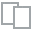
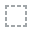
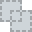
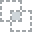
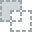
...
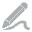
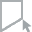
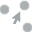
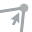
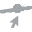

In [18]:
plot(df)

  0%|          | 0/110 [00:00<?, ?it/s]


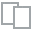
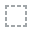
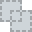
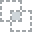
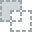
...
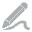
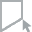
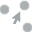
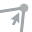
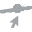

In [11]:
plot(df, 'Chemistry_ChilledWater_Demand_kBtu')

  0%|          | 0/110 [00:00<?, ?it/s]


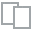
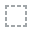
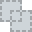
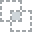
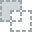
...
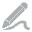
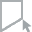
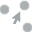
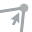
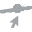

In [21]:
plot(df, 'aiTIT4045')

  0%|          | 0/110 [00:00<?, ?it/s]


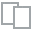
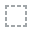
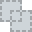
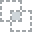
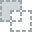
...
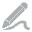
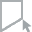
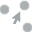
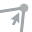
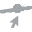

In [22]:
plot(df, 'HDH')

  0%|          | 0/110 [00:00<?, ?it/s]


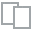
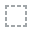
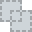
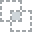
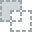
...
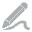
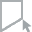
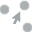
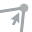
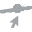

In [23]:
plot(df, 'CDH')

  0%|          | 0/72 [00:00<?, ?it/s]


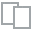
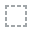
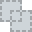
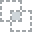
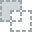
...
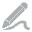
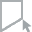
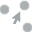
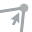
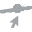

In [24]:
plot(df, 'DayOfWeek')

  0%|          | 0/110 [00:00<?, ?it/s]


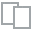
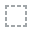
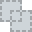
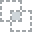
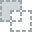
...
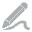
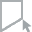
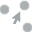
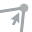
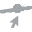

In [25]:
plot(df, 'Month')

  0%|          | 0/110 [00:00<?, ?it/s]


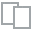
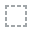
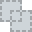
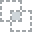
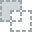
...
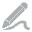
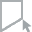
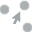
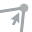
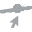

In [26]:
plot(df, 'Hour')

  0%|          | 0/72 [00:00<?, ?it/s]


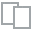
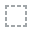
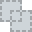
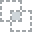
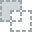
...
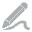
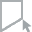
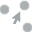
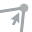
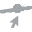

In [27]:
plot(df, 'Holiday')

## Cleaning data

In [ ]:
df.dropna(axis=0, inplace=True)
df.set_index('Timestamp',inplace = True)

df_out = df[['Chemistry_ChilledWater_Demand_kBtu','aiTIT4045']].copy()
IQR = df_out.quantile(0.75) - df_out.quantile(0.25)
df_final = df_out[~((df_out < (Q1 - 3 * IQR)) | (df_out > (Q3 + 3 * IQR)))]

df_final.dropna(axis=0, inplace=True)

df_final.reset_index(inplace=True)
df = df.loc[df_final['Timestamp']]
df.reset_index(inplace = True)


In [ ]:
plt.figure(figsize=(12,8))
plt.plot(df['Chemistry_ChilledWater_Demand_kBtu'], color='#F18F01', linewidth=0.5, alpha = 0.7)


plt.title('Chemistry Electricity Demand', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


In [36]:
from dataprep.eda import plot_correlation


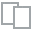
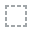
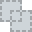
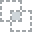
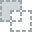
...
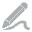
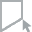
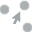
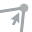
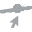

In [37]:
plot_correlation(df)

In [131]:
df.drop(['aiTIT4045', 'DayOfWeek'], inplace=True, axis=1)


## Split

In [19]:
from sklearn.model_selection import train_test_split 

In [132]:
x = df.drop('Chemistry_ChilledWater_Demand_kBtu', axis = 1)
y = df['Chemistry_ChilledWater_Demand_kBtu'].values.reshape(-1,1)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.1, shuffle = False)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size = 0.5, shuffle = False)

print("Shape of X_train is ", X_train.shape)
print("Shape of X_test is ", X_test.shape)
print("Shape of y_val is ", y_val.shape)
print("Shape of y_train is ", y_train.shape)
print("Shape of y_test is ", y_test.shape)
print("Shape of y_val is ", y_val.shape)


Shape of X_train is  (4955, 6)
Shape of X_test is  (275, 6)
Shape of y_val is  (276, 1)
Shape of y_train is  (4955, 1)
Shape of y_test is  (275, 1)
Shape of y_val is  (276, 1)


In [133]:
dates_train = X_train['Timestamp']
dates_test = X_test['Timestamp']
dates_val = X_val['Timestamp']
X_train.drop('Timestamp', axis = 1, inplace = True)
X_test.drop('Timestamp', axis = 1, inplace = True)
X_val.drop('Timestamp', axis = 1, inplace = True)


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Optimization

In [22]:
from sklearn.ensemble import GradientBoostingRegressor

In [23]:
from sklearn.model_selection import RandomizedSearchCV

In [134]:
# Hyperparameter grid
param_grid = {'criterion':['friedman_mse', 'mse'], 'loss':['ls','lad'],'learning_rate':[0.1,0.01, 0.001, 0.05],                               
              'n_estimators':np.linspace(10, 200).astype(int), 'random_state':[1], 'min_samples_split': [2, 5, 10],
             'max_depth': [None] + list(np.linspace(3, 20).astype(int)), 'max_leaf_nodes': [None] + list(np.linspace(10, 50, 500).astype(int))}

# Estimator for use in random search
estimator = GradientBoostingRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_jobs=-1,
                   param_distributions={'criterion': ['friedman_mse', 'mse'],
                                        'learning_rate': [0.1, 0.01, 0.001,
                                                          0.05],
                                        'loss': ['ls', 'lad'],
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                                                      8, 8, 9, 9, 9, 10, 10, 10,
                                                      11, 11, 12, 12, 12, ...],
                                        'max_leaf_nodes': [None, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 11,
                                                           11, 11, 11, 11, 11,
  

In [135]:
rs.best_params_


{'random_state': 1,
 'n_estimators': 196,
 'min_samples_split': 10,
 'max_leaf_nodes': 24,
 'max_depth': 14,
 'loss': 'ls',
 'learning_rate': 0.05,
 'criterion': 'friedman_mse'}

## Model

In [136]:
model = GradientBoostingRegressor(n_estimators = 196, learning_rate = 0.05, loss = 'ls', criterion = 'friedman_mse', 
                                  random_state = 1, min_samples_split = 10, max_leaf_nodes = 24, max_depth = 14)
model.fit(X_train, y_train)


/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


GradientBoostingRegressor(learning_rate=0.05, max_depth=14, max_leaf_nodes=24,
                          min_samples_split=10, n_estimators=196,
                          random_state=1)

In [137]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


### Measures

In [138]:
from sklearn import metrics
from statistics import mean

In [139]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 29572.46852834488
Root Mean Squared Error: 171.96647501284917
Mean Absolute Error: 131.85070914919785
CV(RMSE):  0.10658214743202583


In [140]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.9523781296971433
Testing R-squared:  0.9239934165897215
Validation R-squared:  0.8769512605783214


In [141]:
boost_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
boost_scores

,Measure,Train,Test,Val
0,MSE,20676.736911001935,29572.46852834488,45157.77540436335
1,RMSE,143.79407814997785,171.96647501284917,212.50358915642659
2,MAE,91.0292285896474,131.85070914919785,153.50696981317415
3,CV(RMSE),0.17455106309504942,0.10658214743202583,0.12419810659527315
4,R-squared,0.9523781296971433,0.9239934165897215,0.8769512605783214


In [142]:
#measures.to_csv('scores_annhour.csv', index = False)

In [143]:
import matplotlib as mpl
mpl.style.use('seaborn-whitegrid')

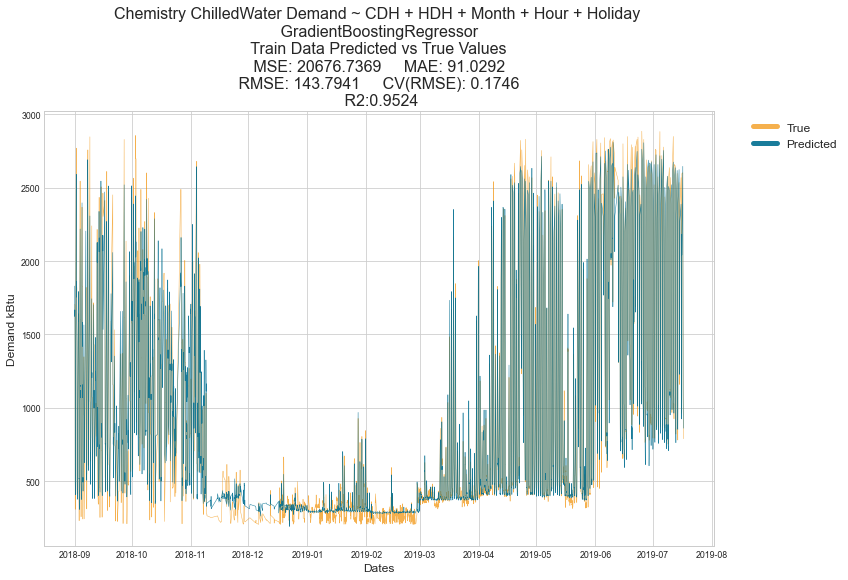

In [144]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + HDH + Month + Hour + Holiday \n GradientBoostingRegressor \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

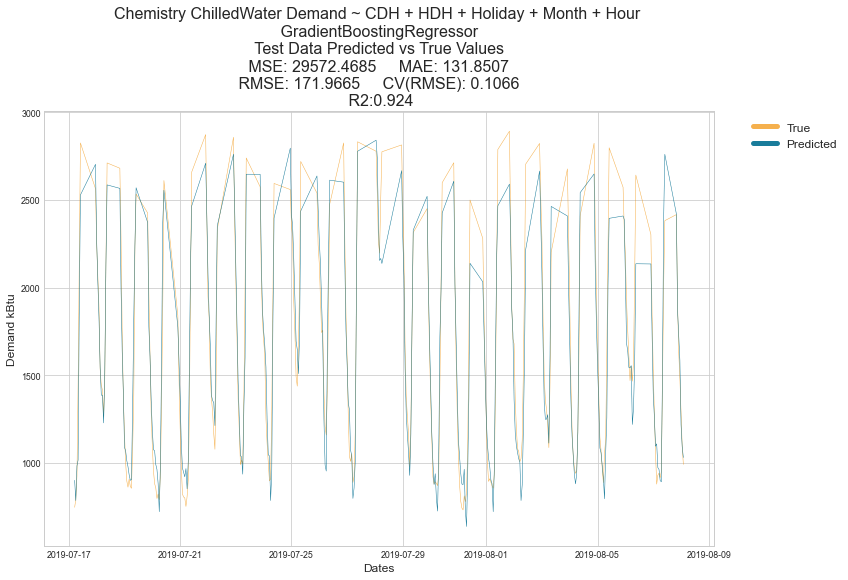

In [145]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + HDH + Holiday + Month + Hour \n GradientBoostingRegressor \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

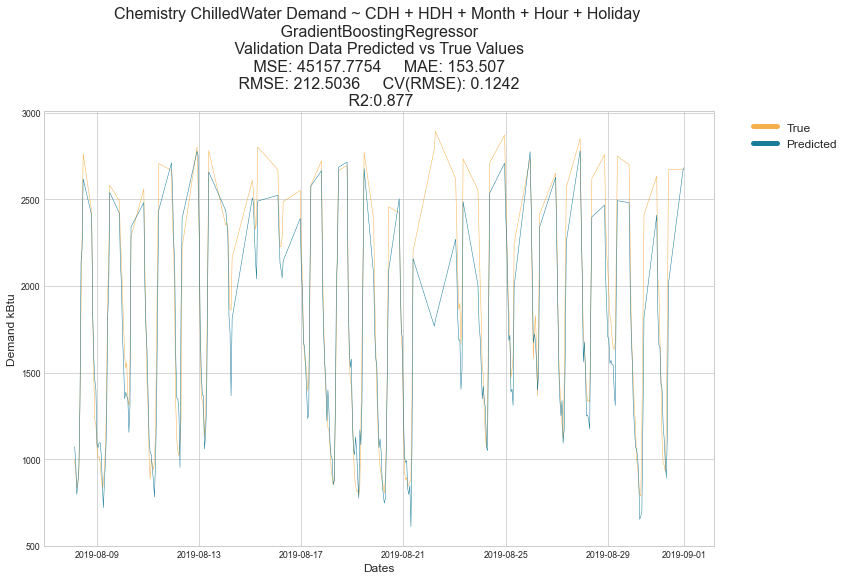

In [146]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + HDH + Month + Hour + Holiday \n GradientBoostingRegressor \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)


# Random Forest

In [147]:
from sklearn.ensemble import RandomForestRegressor

In [148]:
# Hyperparameter grid
param_grid = {
    'n_estimators': np.linspace(10, 200).astype(int),
    'max_depth': [None] + list(np.linspace(3, 20).astype(int)),
    'max_leaf_nodes': [None] + list(np.linspace(10, 50, 500).astype(int)),
    'min_samples_split': [2, 5, 10],
    'bootstrap': [True, False],
    'random_state': [1]
}

# Estimator for use in random search
estimator = RandomForestRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/opt/anaconda3/lib/python3.8/site-packages/sklearn/model_selection/_search.py:880: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                                                      8, 8, 9, 9, 9, 10, 10, 10,
                                                      11, 11, 12, 12, 12, ...],
                                        'max_leaf_nodes': [None, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 11,
                                                           11, 11, 11, 11, 11,
                                                           11, 11, 11, 11, 11,
                                                           11, 12, 12, 12, 12, ...],
                                        'min_samples_spl

In [149]:
rs.best_params_

{'random_state': 1,
 'n_estimators': 168,
 'min_samples_split': 10,
 'max_leaf_nodes': 46,
 'max_depth': 19,
 'bootstrap': True}

## Model

In [150]:
model = RandomForestRegressor(n_estimators = 168, 
                               bootstrap = True,
                               max_depth = 19,
                               max_leaf_nodes = 46,
                               min_samples_split = 10,
                               random_state = 1)
model.fit(X_train, y_train)

<ipython-input-150-ab8663706b04>:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


RandomForestRegressor(max_depth=19, max_leaf_nodes=46, min_samples_split=10,
                      n_estimators=168, random_state=1)

In [151]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


In [152]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 37092.09727945996
Root Mean Squared Error: 192.5930873096435
Mean Absolute Error: 143.34661603264644
CV(RMSE):  0.11936620102547134


In [153]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.9081525544157978
Testing R-squared:  0.9046666130346466
Validation R-squared:  0.846271033163908


In [154]:
forest_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
forest_scores


,Measure,Train,Test,Val
0,MSE,39878.85096100889,37092.09727945996,56417.14161523564
1,RMSE,199.69689772504952,192.5930873096435,237.52292860950422
2,MAE,124.05647465775272,143.34661603264644,172.73957735005084
3,CV(RMSE),0.24241127481157065,0.11936620102547134,0.13882070473901226
4,R-squared,0.9081525544157978,0.9046666130346466,0.846271033163908


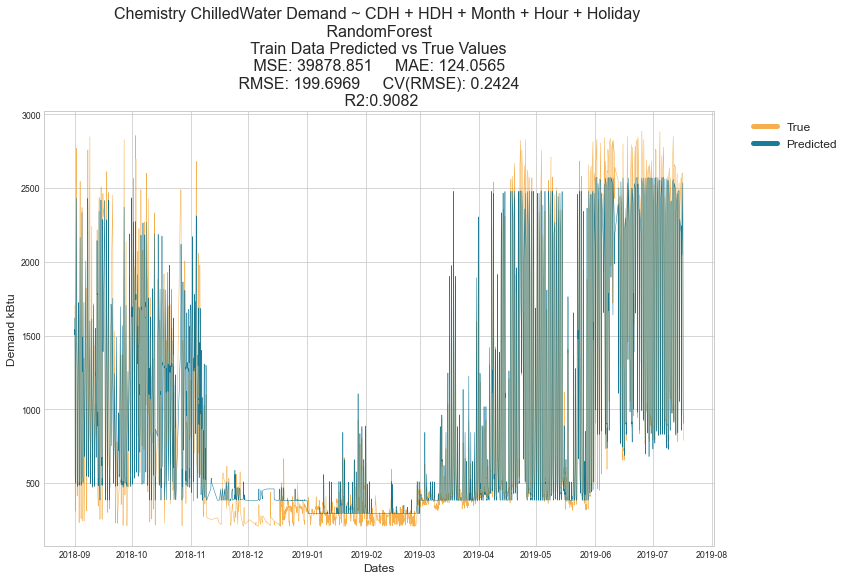

In [155]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + HDH + Month + Hour + Holiday \n RandomForest \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

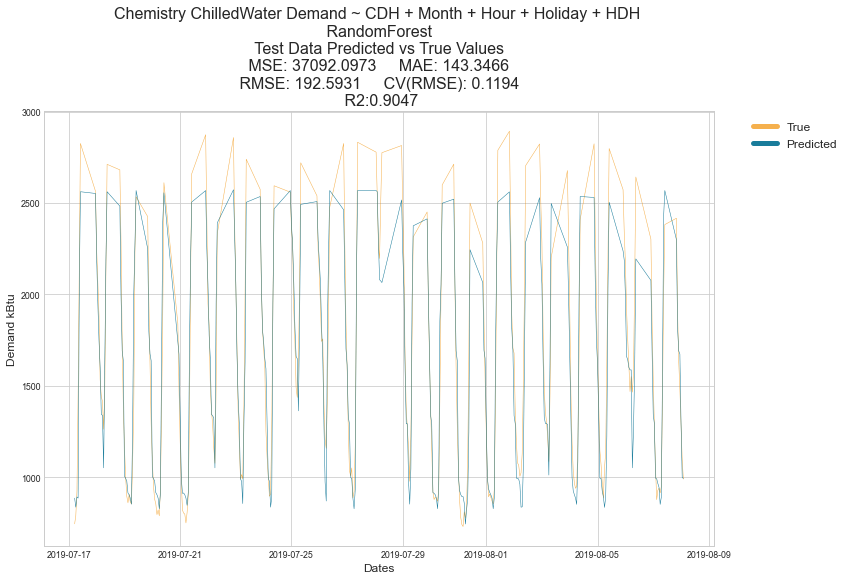

In [156]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n RandomForest \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

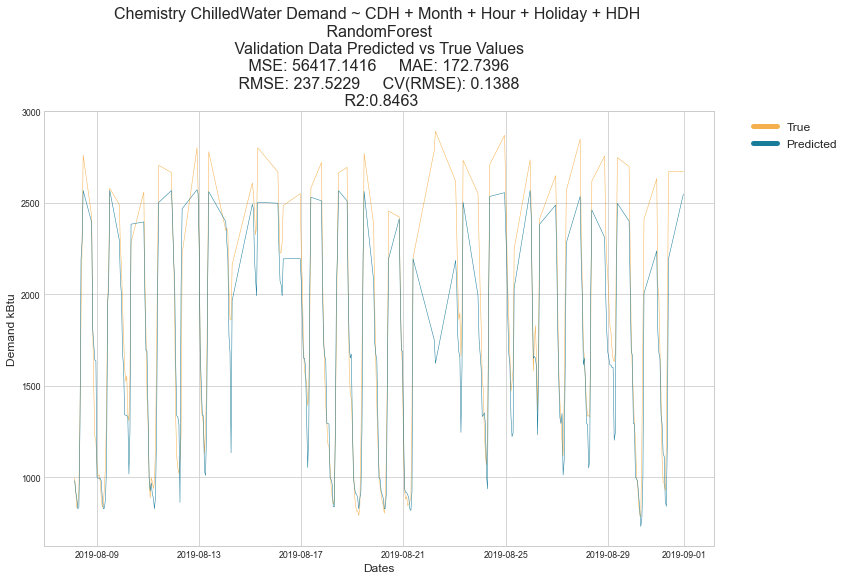

In [157]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n RandomForest \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

# lightGBM Regressor

## Dummies

In [158]:
df_dd = df.copy()

In [159]:
dummy_h = pd.get_dummies(df_dd['Hour'])
dummy_h.head()

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [160]:
df_h_dummies = pd.concat([df_dd, dummy_h], axis=1)      
df_h_dummies.drop(['Hour', 23], inplace=True, axis=1)
df_h_dummies = df_h_dummies.rename(columns={0:'h_0', 1: 'h_1', 2:'h_2', 3:'h_3', 4:'h_4', 5:'h_5', 6:'h_6', 
                                              7:'h_7', 8:'h_8', 9:'h_9', 10:'h_10', 11:'h_11', 12:'h_12', 
                                              13:'h_13',14:'h_14',15:'h_15',16:'h_16',17:'h_17',18:'h_18',
                                              19:'h_19',20:'h_20',21:'h_21',22:'h_22'})
df_h_dummies.head()

,Timestamp,Chemistry_ChilledWater_Demand_kBtu,HDH,CDH,Holiday,Month,h_0,h_1,h_2,h_3,...,h_13,h_14,h_15,h_16,h_17,h_18,h_19,h_20,h_21,h_22
0,2018-09-01 00:00:00,1704.0,0.000000,4.289731,1.0,9,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2018-09-01 01:00:00,1704.0,0.000000,0.318193,1.0,9,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2018-09-01 02:00:00,1704.0,0.635047,0.403285,1.0,9,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,2018-09-01 03:00:00,1704.0,0.995677,0.991373,1.0,9,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,2018-09-01 04:00:00,1704.0,1.712568,2.932888,1.0,9,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [161]:
dummy_m = pd.get_dummies(df_dd['Month'])
dummy_m.head()

,1,2,3,4,5,6,7,8,9,10,11,12
0,0,0,0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0


In [162]:
df_m_dummies = pd.concat([df_h_dummies, dummy_m], axis=1)      
df_m_dummies.drop(['Month', 12], inplace=True, axis=1)
df_m_dummies = df_m_dummies.rename(columns={1: 'm_1', 2:'m_2', 3:'m_3', 4:'m_4', 5:'m_5', 6:'m_6', 
                                              7:'m_7', 8:'m_8', 9:'m_9', 10:'m_10', 11:'m_11'})
df_m_dummies.head()

,Timestamp,Chemistry_ChilledWater_Demand_kBtu,HDH,CDH,Holiday,h_0,h_1,h_2,h_3,h_4,...,m_2,m_3,m_4,m_5,m_6,m_7,m_8,m_9,m_10,m_11
0,2018-09-01 00:00:00,1704.0,0.000000,4.289731,1.0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,2018-09-01 01:00:00,1704.0,0.000000,0.318193,1.0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,2018-09-01 02:00:00,1704.0,0.635047,0.403285,1.0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
3,2018-09-01 03:00:00,1704.0,0.995677,0.991373,1.0,0,0,0,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2018-09-01 04:00:00,1704.0,1.712568,2.932888,1.0,0,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0


## Split

In [163]:
x = df_m_dummies.drop('Chemistry_ChilledWater_Demand_kBtu', axis = 1)
y = df_m_dummies['Chemistry_ChilledWater_Demand_kBtu'].values.reshape(-1,1)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.1, shuffle = False)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size = 0.5, shuffle = False)

print("Shape of X_train is ", X_train.shape)
print("Shape of X_test is ", X_test.shape)
print("Shape of y_val is ", y_val.shape)
print("Shape of y_train is ", y_train.shape)
print("Shape of y_test is ", y_test.shape)
print("Shape of y_val is ", y_val.shape)

Shape of X_train is  (4955, 38)
Shape of X_test is  (275, 38)
Shape of y_val is  (276, 1)
Shape of y_train is  (4955, 1)
Shape of y_test is  (275, 1)
Shape of y_val is  (276, 1)


In [164]:
dates_train = X_train['Timestamp']
dates_test = X_test['Timestamp']
dates_val = X_val['Timestamp']
X_train.drop('Timestamp', axis = 1, inplace = True)
X_test.drop('Timestamp', axis = 1, inplace = True)
X_val.drop('Timestamp', axis = 1, inplace = True)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## RandomSearch

In [165]:
from lightgbm import LGBMRegressor


In [169]:
# Hyperparameter grid
param_grid = {'learning_rate':[0.1,0.01, 0.001, 0.05],                               
              'n_estimators':np.linspace(10, 200).astype(int), 'random_state':[1], 
             'max_depth': [None] + list(np.linspace(3, 20).astype(int)), 'num_leaves': [None] + list(np.linspace(10, 50, 500).astype(int))}

# Estimator for use in random search
estimator = LGBMRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=LGBMRegressor(), n_jobs=-1,
                   param_distributions={'learning_rate': [0.1, 0.01, 0.001,
                                                          0.05],
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                                                      8, 8, 9, 9, 9, 10, 10, 10,
                                                      11, 11, 12, 12, 12, ...],
                                        'n_estimators': array([ 10,  13,  17,  21,  25,  29,  33,  37,  41,  44,  48,  52,  56,
        60,  64,  68,  72,  75,  79,  83,  87,  91,  95,  99, 103, 106,
       110, 114, 118, 122, 126, 130, 134, 137, 141, 145, 149, 153, 157,
       161, 165, 168, 172, 176, 180, 184, 188, 192, 196, 200]),
                                        'num_leaves': [None, 10, 10, 10, 10, 10,
                                                       1

In [170]:
rs.best_params_

{'random_state': 1,
 'num_leaves': 48,
 'n_estimators': 75,
 'max_depth': 9,
 'learning_rate': 0.05}

## Model

In [172]:
model = LGBMRegressor(n_estimators = 75, learning_rate = 0.05, max_depth = 9, num_leaves = 48, random_state = 1)
model.fit(X_train, y_train)


LGBMRegressor(learning_rate=0.05, max_depth=9, n_estimators=75, num_leaves=48,
              random_state=1)

In [173]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


In [174]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 66383.79938384856
Root Mean Squared Error: 257.6505373249754
Mean Absolute Error: 202.7601459171739
CV(RMSE):  0.1596877970142689


In [175]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.8800356748093775
Testing R-squared:  0.8293816500261545
Validation R-squared:  0.6260719385496618


In [176]:
lightgbm_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
lightgbm_scores


,Measure,Train,Test,Val
0,MSE,52086.799088266605,66383.79938384856,137228.21944966982
1,RMSE,228.22532525613062,257.6505373249754,370.4432742670189
2,MAE,132.97024192744132,202.7601459171739,316.78164873361357
3,CV(RMSE),0.2770418202279575,0.1596877970142689,0.21650624089482975
4,R-squared,0.8800356748093775,0.8293816500261545,0.6260719385496618


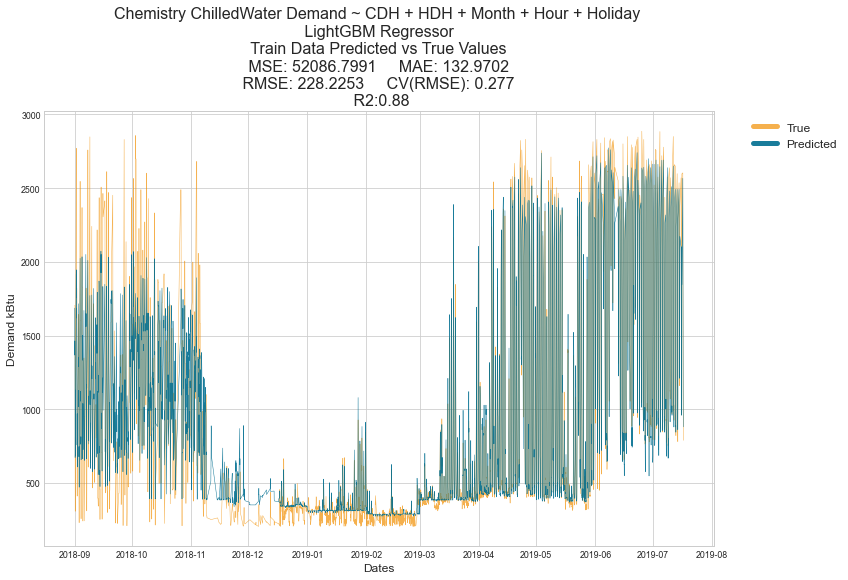

In [177]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + HDH + Month + Hour + Holiday \n LightGBM Regressor \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

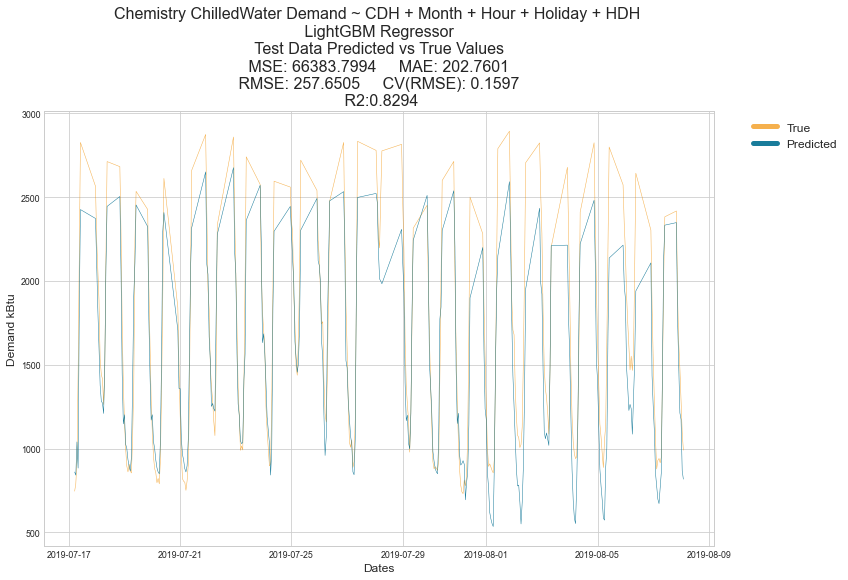

In [178]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n LightGBM Regressor \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

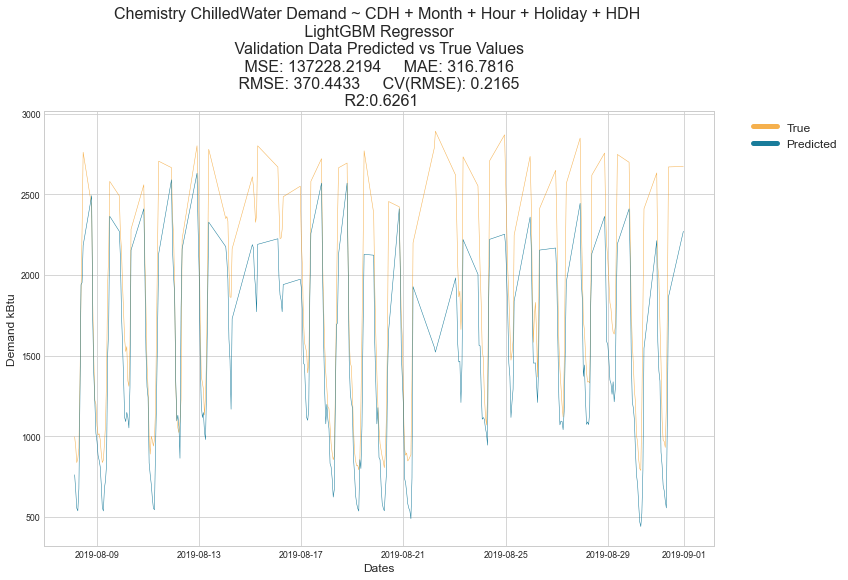

In [179]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n LightGBM Regressor \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

# XGBoost

In [180]:
from xgboost import XGBRegressor

In [181]:
# Hyperparameter grid
param_grid = {'learning_rate':[0.1,0.01, 0.001, 0.05],                               
              'n_estimators':np.linspace(10, 200).astype(int), 'random_state':[1],
             'max_depth': [None] + list(np.linspace(3, 20).astype(int))}

# Estimator for use in random search
estimator = XGBRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, gamma=None,
                                          gpu_id=None, importance_type='gain',
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n...
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                            

In [182]:
rs.best_params_


{'random_state': 1, 'n_estimators': 145, 'max_depth': 6, 'learning_rate': 0.1}

## Model

In [183]:
model = XGBRegressor(n_estimators = 145, learning_rate = 0.1, max_depth = 6, random_state = 1)
model.fit(X_train, y_train)


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=145, n_jobs=4, num_parallel_tree=1, random_state=1,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [184]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


In [185]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 55134.332239223404
Root Mean Squared Error: 234.80701062622344
Mean Absolute Error: 178.05352759103872
CV(RMSE):  0.14552973434367059


In [186]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.9475684140780853
Testing R-squared:  0.8582948116727582
Validation R-squared:  0.6741316205192791


In [187]:
xgboost_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
xgboost_scores


,Measure,Train,Test,Val
0,MSE,22765.046837502934,55134.332239223404,119590.7504712046
1,RMSE,150.88090282571528,234.80701062622344,345.81895620570685
2,MAE,89.57991493015695,178.05352759103872,290.9030815736491
3,CV(RMSE),0.18315373155701478,0.14552973434367059,0.20211451371716077
4,R-squared,0.9475684140780853,0.8582948116727582,0.6741316205192791


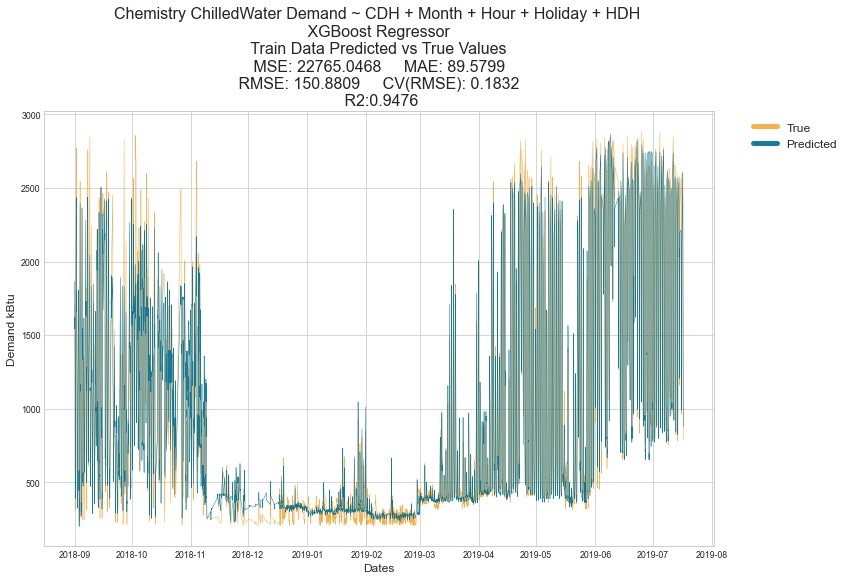

In [188]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n XGBoost Regressor \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

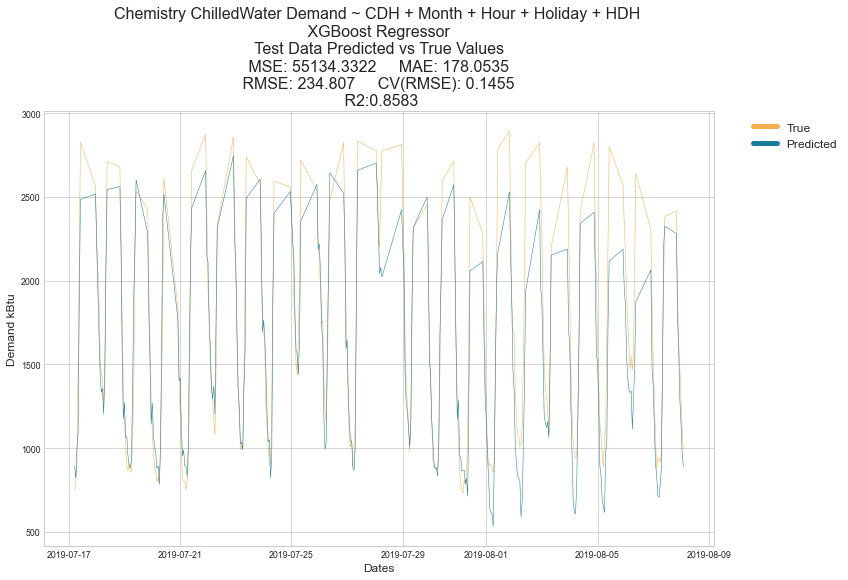

In [189]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n XGBoost Regressor \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

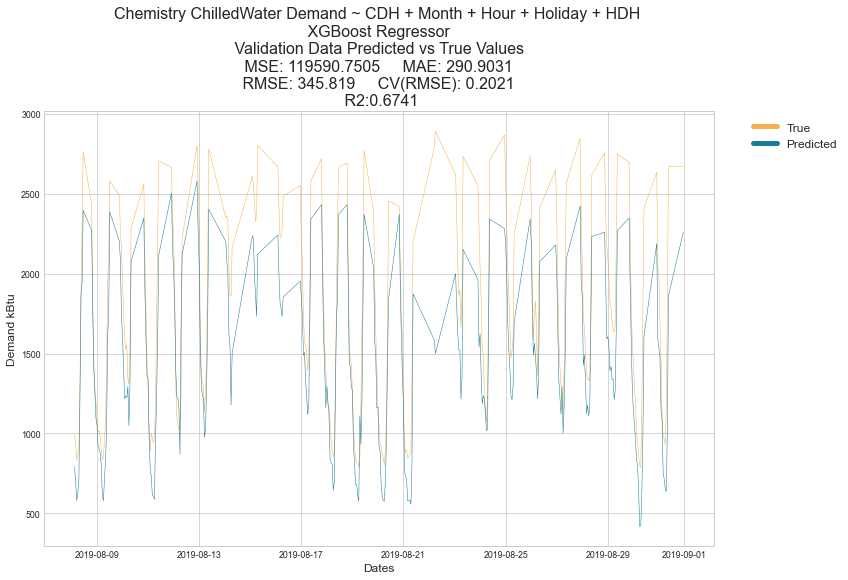

In [190]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry ChilledWater Demand ~ CDH + Month + Hour + Holiday + HDH \n XGBoost Regressor \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

# Comparisson

In [191]:
#r2
r2 = pd.DataFrame()
r2['Dataset'] = ['Train', 'Test', 'Validation']
r2['LightGBM'] = lightgbm_scores[lightgbm_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['RandomForest'] = forest_scores[forest_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['XGBoost'] = xgboost_scores[xgboost_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2.set_index('Dataset', drop = True, inplace = True)

#cv(rmse)
cv = pd.DataFrame()
cv['Dataset'] = ['Train', 'Test', 'Validation']
cv['LightGBM'] = lightgbm_scores[lightgbm_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['RandomForest'] = forest_scores[forest_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['XGBoost'] = xgboost_scores[xgboost_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv.set_index('Dataset', drop = True, inplace = True)

#mae
mae = pd.DataFrame()
mae['Dataset'] = ['Train', 'Test', 'Validation']
mae['LightGBM'] = lightgbm_scores[lightgbm_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['RandomForest'] = forest_scores[forest_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['XGBoost'] = xgboost_scores[xgboost_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae.set_index('Dataset', drop = True, inplace = True)

mae

,LightGBM,RandomForest,XGBoost,GradientBoosting
Dataset,,,,
Train,132.970242,124.056475,89.579915,91.029229
Test,202.760146,143.346616,178.053528,131.850709
Validation,316.781649,172.739577,290.903082,153.506970


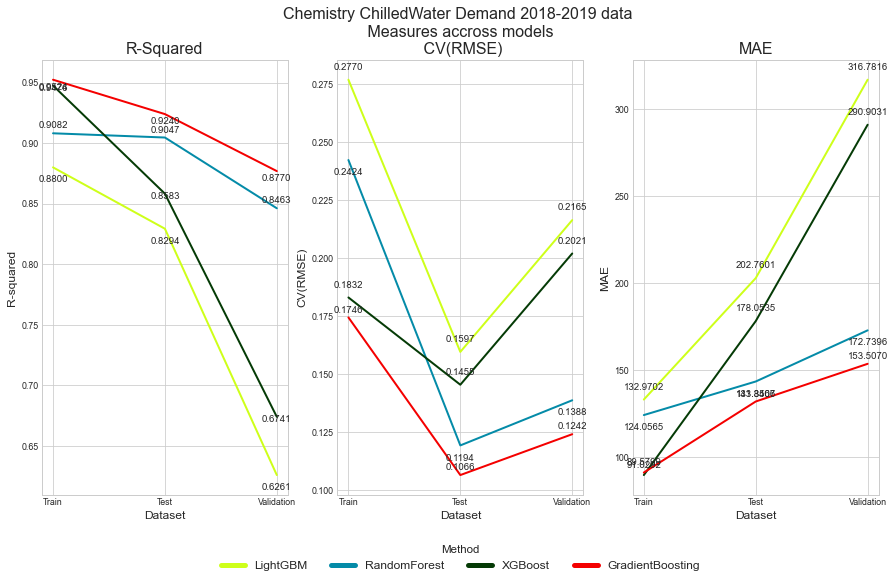

In [192]:
plt.figure(figsize=(15,8))

# R2
plt.subplot(1,3,1)
plt.plot(r2['LightGBM'], color='#CEFF1A', linewidth=2)
plt.plot(r2['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(r2['XGBoost'], color='#053B06', linewidth=2)
plt.plot(r2['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('R-Squared', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('R-squared', fontsize = 12)

for x,y in zip(['Train','Test','Validation'], r2['LightGBM']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-15), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['XGBoost']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-5), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-10), ha = 'center') 

# CV(RMSE)
plt.subplot(1,3,2)
plt.plot(cv['LightGBM'], color='#CEFF1A', linewidth=2)
plt.plot(cv['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(cv['XGBoost'], color='#053B06', linewidth=2)
plt.plot(cv['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('Chemistry ChilledWater Demand 2018-2019 data \n Measures accross models \n CV(RMSE)', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('CV(RMSE)', fontsize = 12)

leg = plt.legend(labels = ['LightGBM','RandomForest', 'XGBoost', 'GradientBoosting'], loc = "lower center", bbox_to_anchor=(0.5, -0.2),ncol = 4, title = 'Method', title_fontsize = 'large', fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    
for x,y in zip(['Train','Test','Validation'], cv['LightGBM']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-15), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['XGBoost']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 
    
# MAE
plt.subplot(1,3,3)
plt.plot(mae['LightGBM'], color='#CEFF1A', linewidth=2)
plt.plot(mae['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(mae['XGBoost'], color='#053B06', linewidth=2)
plt.plot(mae['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('MAE', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('MAE', fontsize = 12)

for x,y in zip(['Train','Test','Validation'], mae['LightGBM']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-15), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['XGBoost']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 
